# **CNN V.1**

## Requirements

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving requirements.txt to requirements.txt


In [ ]:
%pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.0/58.0 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.9/85.9 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 260.1/260.1 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 81.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.4/113.4 kB 11.8 MB/s eta 0:00:00
  Attempting uninstall: librosa
    Found existing installation: librosa 0.11.0
    Uninstalling librosa-0.11.0:
      Successfully uninstalled librosa-0.11.0


## Libraries

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import librosa
import sklearn
import tensorflow as tf
import IPython
import tqdm
from tensorflow.keras.callbacks import CSVLogger, EarlyStopping, ModelCheckpoint, LearningRateScheduler
import pandas as pd
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler
plt.style.use("seaborn-v0_8")

from audiomentations import AddGaussianSNR, PitchShift, TimeStretch, ApplyImpulseResponse
from pedalboard import Pedalboard, Compressor


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
tf.debugging.set_log_device_placement(True)

## Dataset

Required [ESC-50 Dataset](https://github.com/karolpiczak/ESC-50/archive/master.zip)

In [ ]:
!wget https://github.com/karolpiczak/ESC-50/archive/master.zip
!unzip master.zip

--2025-06-05 13:57:17--  https://github.com/karolpiczak/ESC-50/archive/master.zip
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/karolpiczak/ESC-50/zip/refs/heads/master [following]
--2025-06-05 13:57:17--  https://codeload.github.com/karolpiczak/ESC-50/zip/refs/heads/master
Resolving codeload.github.com (codeload.github.com)... 140.82.114.10
Connecting to codeload.github.com (codeload.github.com)|140.82.114.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘master.zip’

master.zip              [             <=>    ] 615.78M  14.7MB/s    in 40s     

2025-06-05 13:57:57 (15.6 MB/s) - ‘master.zip’ saved [645695005]

Archive:  master.zip
33c8ce9eb2cf0b1c2f8bcf322eb349b6be34dbb6
   creating: ESC-50-master/
   creating: ESC-50-master/.circleci/
  inflating: ESC-50-

### Loading of the dataset of the metadata and dataset analysis

In [ ]:
fn_csv = 'ESC-50-master/meta/esc50.csv'

ds_files = []  # File list
ds_labels = []  # Class list

ds = pd.read_csv(fn_csv)
ds.head()

,filename,fold,target,category,esc10,src_file,take
0,1-100032-A-0.wav,1,0,dog,True,100032,A
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A


In [ ]:
#unique class labels
unique_classes = ds['category'].unique()
print("Unique classes:", unique_classes)

# Check the number of unique class labels
print("Count:", len(unique_classes))

# Filling the lists with filenames and labels
ds_files = ds['filename'].values
pure_ds_labels = ds['category'].values

Unique classes: ['dog' 'chirping_birds' 'vacuum_cleaner' 'thunderstorm' 'door_wood_knock'
 'can_opening' 'crow' 'clapping' 'fireworks' 'chainsaw' 'airplane'
 'mouse_click' 'pouring_water' 'train' 'sheep' 'water_drops'
 'church_bells' 'clock_alarm' 'keyboard_typing' 'wind' 'footsteps' 'frog'
 'cow' 'brushing_teeth' 'car_horn' 'crackling_fire' 'helicopter'
 'drinking_sipping' 'rain' 'insects' 'laughing' 'hen' 'engine' 'breathing'
 'crying_baby' 'hand_saw' 'coughing' 'glass_breaking' 'snoring'
 'toilet_flush' 'pig' 'washing_machine' 'clock_tick' 'sneezing' 'rooster'
 'sea_waves' 'siren' 'cat' 'door_wood_creaks' 'crickets']
Count: 50


Check whether Ydata is balanced or not by plotting the histogram.

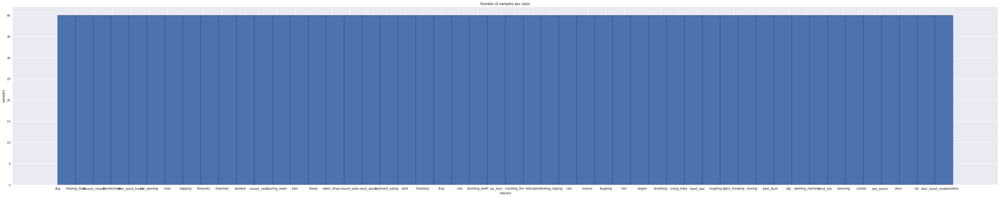

In [ ]:
plt.figure(figsize=(55, 10))
plt.title("Number of samples per class")
plt.hist(np.asarray(pure_ds_labels), bins=50, edgecolor='black')
plt.xlabel("classes")
plt.ylabel("samples")
plt.show()

Transient sound:


Continous sound:


Intermittent sound:


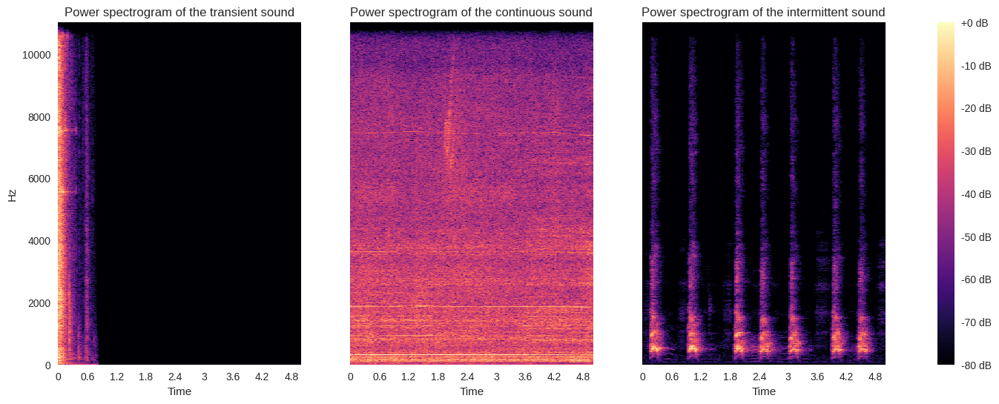

In [ ]:
# Setup some filepaths
path = 'ESC-50-master/audio/'
file0 = path + '1-84705-A-39.wav'  # Transient
file1 = path + '1-19872-A-36.wav'  # Continuous
file2 = path + '1-30344-A-0.wav'   # Intermittent

name = ['transient', 'continuous', 'intermittent']

# Show audio player for each file
print('Transient sound:')
IPython.display.display(IPython.display.Audio(data=file0))
print('Continous sound:')
IPython.display.display(IPython.display.Audio(data=file1))
print('Intermittent sound:')
IPython.display.display(IPython.display.Audio(data=file2))

# Plot mel specs
files = [file0, file1, file2]
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))
for i in range(3):
  y, sr = librosa.load(files[i])
  D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
  img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, ax=ax[i])
  ax[i].set(title='Power spectrogram of the ' + name[i] + ' sound')
  ax[i].label_outer()
fig.colorbar(img, ax=ax, format="%+2.f dB")
plt.show()

Fra quelli simili si fa confusione: se vuelve loco

Washing machine sound:


Helicopter sound:


Engine sound:


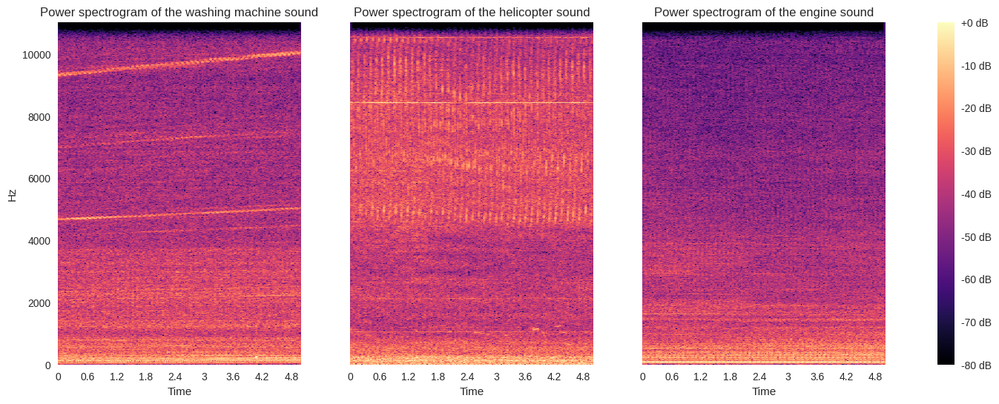

In [ ]:
# Setup some filepaths
path = 'ESC-50-master/audio/'
file0 = path + '1-23996-B-35.wav'     # La Lavadora
file1 = path + '1-172649-A-40.wav'    # El helicoptero
file2 = path + '5-232272-A-44.wav'    # El coche


name = ['washing machine', 'helicopter', 'engine']

# Show audio player for each file
print('Washing machine sound:')
IPython.display.display(IPython.display.Audio(data=file0))
print('Helicopter sound:')
IPython.display.display(IPython.display.Audio(data=file1))
print('Engine sound:')
IPython.display.display(IPython.display.Audio(data=file2))

# Plot mel specs
files = [file0, file1, file2]
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))
for i in range(3):
  y, sr = librosa.load(files[i])
  D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
  img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, ax=ax[i])
  ax[i].set(title='Power spectrogram of the ' + name[i] + ' sound')
  ax[i].label_outer()
fig.colorbar(img, ax=ax, format="%+2.f dB")
plt.show()

Se vogliamo mettere come c'è un'alta variabilità nella stessa classe. Vogliamo l'abbaio

First dog sound:


Second dog sound:


Third dog sound:


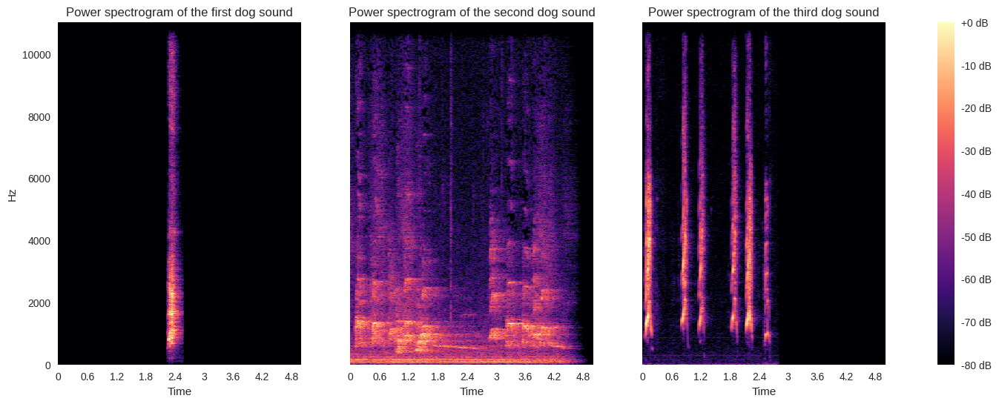

In [ ]:
# Setup some filepaths
path = 'ESC-50-master/audio/'
file0 = path + '1-100032-A-0.wav'     # El perro limpio
file1 = path + '3-136288-A-0.wav'     # El perro en la lavadora
file2 = path + '5-9032-A-0.wav'       # El perro sucio

name = ['first dog', 'second dog', 'third dog']

# Show audio player for each file
print('First dog sound:')
IPython.display.display(IPython.display.Audio(data=file0))
print('Second dog sound:')
IPython.display.display(IPython.display.Audio(data=file1))
print('Third dog sound:')
IPython.display.display(IPython.display.Audio(data=file2))

# Plot mel specs
files = [file0, file1, file2]
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))
for i in range(3):
  y, sr = librosa.load(files[i])
  D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
  img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, ax=ax[i])
  ax[i].set(title='Power spectrogram of the ' + name[i] + ' sound')
  ax[i].label_outer()
fig.colorbar(img, ax=ax, format="%+2.f dB")
plt.show()

Un'altra cosa da far notare è che non esiste una vera conoscenza e struttura di suoni ambientali ('o ritmo, o suono, 'o mare). Harmonic percussion

Harmonic component


Percussive component


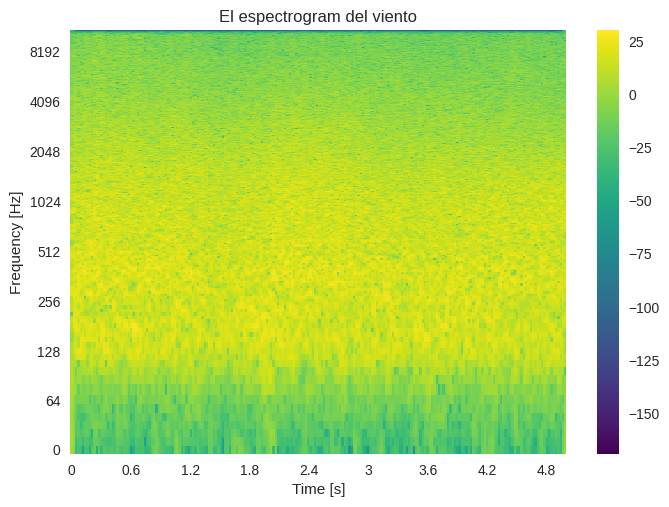

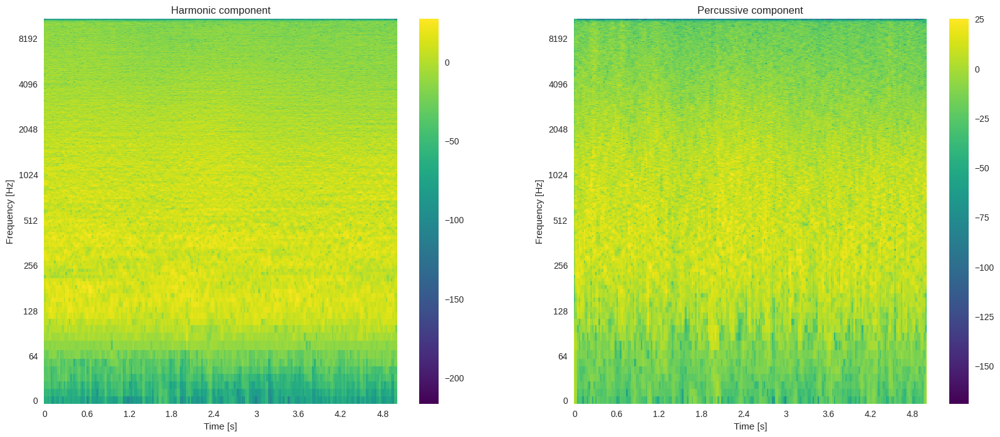

In [ ]:
path = 'ESC-50-master/audio/'
file0 = path + '1-51037-A-16.wav'     # El viento

sound, sr = librosa.load(file0)

S = librosa.stft(sound)

librosa.display.specshow(20*np.log10(np.abs(S)+np.finfo(float).eps), sr=sr, x_axis='time', y_axis='log', cmap='viridis')
plt.title(f'El espectrogram del viento')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.colorbar()

Hmm, Prs = librosa.decompose.hpss(S)

plt.figure(figsize=(20,8))

plt.subplot(1, 2, 1)
librosa.display.specshow(20*np.log10(np.abs(Hmm)+np.finfo(float).eps), sr=sr, x_axis='time', y_axis='log', cmap='viridis')
plt.title(f'Harmonic component')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.colorbar()

plt.subplot(1, 2, 2)
librosa.display.specshow(20*np.log10(np.abs(Prs)+np.finfo(float).eps), sr=sr, x_axis='time', y_axis='log', cmap='viridis')
plt.title(f'Percussive component')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.colorbar()

print(f'Harmonic component')
IPython.display.display(IPython.display.Audio(librosa.istft(Hmm), rate=sr))
print(f'Percussive component')
IPython.display.display(IPython.display.Audio(librosa.istft(Prs), rate=sr))

## Pre-processing

Required [MIT Acoustical Reverberation Scene Statistics Survey](https://mcdermottlab.mit.edu/Reverb/IRMAudio/Audio.zip)

We decided to use audiomentations instead of the PyTorch one in order to have compressors.
-	Add different background noises with different SNRs
-	Pitch shifting
-	Time stretching
-	Dynamic range compression
-	Convolution with impulse responses

Background noise

In [ ]:
def addGaussianNoise(signal, sr, min_snr_db, max_snr_db, activation_prob):
    """
    Adds Gaussian noise to the audio signal with a specified SNR range and activation probability.
    Args:
        signal (np.ndarray): The audio signal to augment.
        sr (int): Sample rate of the audio signal.
        min_snr_db (float): Minimum SNR in dB.
        max_snr_db (float): Maximum SNR in dB.
        activation_prob (float): Probability of applying the augmentation.
    Returns:
        np.ndarray: The augmented audio signal with Gaussian noise added.
    """

    transform = AddGaussianSNR(
        min_snr_db=min_snr_db,
        max_snr_db=max_snr_db,
        p=activation_prob
    )
    augmented_signal = transform(samples=signal, sample_rate=sr)
    return augmented_signal

Pitch Shifting

In [ ]:
def pitchShifter(signal, sr, min_semitones, max_semitones, activation_prob):
    """
    Shifts the pitch of the audio signal by a random number of semitones within a specified range.
    Args:
        signal (np.ndarray): The audio signal to augment.
        sr (int): Sample rate of the audio signal.
        min_semitones (int): Minimum number of semitones to shift.
        max_semitones (int): Maximum number of semitones to shift.
        activation_prob (float): Probability of applying the augmentation.
    Returns:
        np.ndarray: The augmented audio signal with pitch shifted.
    """

    transform = PitchShift(
        min_semitones=min_semitones,
        max_semitones=max_semitones,
        p=activation_prob
    )
    augmented_signal = transform(samples=signal, sample_rate=sr)
    return augmented_signal

Time Stretching

In [ ]:
def timeStretcher(signal, sr, min_rate, max_rate, activation_prob, leave_length_unchanged=True):
    """
    Stretches or compresses the audio signal in time by a random factor within a specified range.
    Args:
        signal (np.ndarray): The audio signal to augment.
        sr (int): Sample rate of the audio signal.
        min_rate (float): Minimum stretch/compression rate.
        max_rate (float): Maximum stretch/compression rate.
        activation_prob (float): Probability of applying the augmentation.
        leave_length_unchanged (bool): If True, the length of the output signal will be the same as the input.
    Returns:
        np.ndarray: The augmented audio signal with time-stretching applied.
    """

    transform = TimeStretch(
        min_rate=min_rate,
        max_rate=max_rate,
        leave_length_unchanged=leave_length_unchanged,
        p=activation_prob
    )

    augmented_sound = transform(signal, sample_rate=sr)
    return augmented_sound

Compressor

In [ ]:
def compressor(signal, sr, threshold_db, ratio, attack_ms, release_ms):
    """
    Applies a compressor to the audio signal.
    Args:
        signal (np.ndarray): The audio signal to compress.
        sr (int): Sample rate of the audio signal.
        threshold_db (float): Threshold in dB for the compressor.
        ratio (float): Compression ratio.
        attack_ms (int): Attack time in milliseconds.
        release_ms (int): Release time in milliseconds.
    Returns:
        np.ndarray: The compressed audio signal.
    """

    original_dtype = signal.dtype

    if signal.ndim == 1:
        signal = np.expand_dims(signal, axis=1)  # from [samples] to [samples, 1]

    signal = signal.T  # from [samples, channels] to [channels, samples]

    board = Pedalboard([
        Compressor(threshold_db=threshold_db, ratio=ratio, attack_ms=attack_ms, release_ms=release_ms),
    ])

    processed = board(signal, sr)  # output shape: [channels, samples]

    # Back to [samples, channels]
    augmented_sound = processed.T

    # Convert to the original dtype
    if augmented_sound.dtype != original_dtype:
        if np.issubdtype(original_dtype, np.integer):
            max_val = np.max(np.abs(augmented_sound))
            if max_val > 0:
                normalized = augmented_sound / max_val
            else:
                normalized = augmented_sound
            info = np.iinfo(original_dtype)
            scaled = (normalized * info.max).clip(info.min, info.max).astype(original_dtype)
            augmented_sound = scaled
        else:
            augmented_sound = augmented_sound.astype(original_dtype)

    augmented_sound = np.squeeze(augmented_sound)  # Remove any singleton dimensions

    return augmented_sound

Impulse respones convolution

In [ ]:
def convolver(signal, sr, activation_prob):
    """
    Applies an impulse response to the audio signal to simulate reverberation.
    Args:
        signal (np.ndarray): The audio signal to convolve.
        sr (int): Sample rate of the audio signal.
        activation_prob (float): Probability of applying the convolution.
    Returns:
        np.ndarray: The augmented audio signal with convolution applied.
    """

    transform = ApplyImpulseResponse(ir_path="/content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene", p=activation_prob)

    augmented_sound = transform(signal, sample_rate=sr)

    return augmented_sound

Pre-processing for a single track

In [ ]:
def preProcessingSignal(
    signal, sr,
    label,
    gaussianParameters=None,
    pitchParameters=None,
    timeStretchParameters=None,
    compressorParameters=None,
    convolverParameters=None
    ):
    """
    Preprocesses the audio signal by applying various augmentations based on the provided parameters.
    Args:
        signal (np.ndarray): The audio signal to preprocess.
        sr (int): Sample rate of the audio signal.
        label (str): Label for the audio signal.
        gaussianParameters (tuple, optional): Parameters for Gaussian noise augmentation (min_snr_db, max_snr_db, activation_prob).
        pitchParameters (tuple, optional): Parameters for pitch shifting (min_semitones, max_semitones, activation_prob).
        timeStretchParameters (tuple, optional): Parameters for time stretching (min_rate, max_rate, activation_prob, leave_length_unchanged).
        compressorParameters (tuple, optional): Parameters for compression (threshold_db, ratio, attack_ms, release_ms).
        convolverParameters (float, optional): Probability of applying convolution with impulse response.
    Returns:
        tuple: A tuple containing a list of processed signals and their corresponding labels.
    """

    signals = []
    labels = []

    signals.append(signal)
    labels.append(label)

    if gaussianParameters is not None:
        min_snr_db, max_snr_db, activation_prob = gaussianParameters
        signal_1 = addGaussianNoise(signal, sr, min_snr_db, max_snr_db, activation_prob)
        print(f"Added Gaussian noise with SNR range: {min_snr_db} to {max_snr_db} dB, activation probability: {activation_prob}")
        signals.append(signal_1)
        labels.append(label)

    if pitchParameters is not None:
        min_semitones, max_semitones, activation_prob = pitchParameters
        signal_2 = pitchShifter(signal, sr, min_semitones, max_semitones, activation_prob)
        print(f"Pitch shifted by {min_semitones} to {max_semitones} semitones, activation probability: {activation_prob}")
        signals.append(signal_2)
        labels.append(label)

    if timeStretchParameters is not None:
        min_rate, max_rate, activation_prob, leave_length_unchanged = timeStretchParameters
        signal_3 = timeStretcher(signal, sr, min_rate, max_rate, activation_prob, leave_length_unchanged)
        print(f"Time stretched/compressed by a factor of {min_rate} to {max_rate}, activation probability: {activation_prob}, leave length unchanged: {leave_length_unchanged}")
        signals.append(signal_3)
        labels.append(label)

    if compressorParameters is not None:
        threshold_db, ratio, attack_ms, release_ms = compressorParameters
        signal_4 = compressor(signal, sr, threshold_db, ratio, attack_ms, release_ms)
        print(f"Applied compressor with threshold: {threshold_db} dB, ratio: {ratio}, attack: {attack_ms} ms, release: {release_ms} ms")
        signals.append(signal_4)
        labels.append(label)

    if convolverParameters is not None:
        activation_prob = convolverParameters
        signal_5 = convolver(signal, sr, activation_prob)
        print(f"Applied convolution with impulse response, activation probability: {activation_prob}")
        signals.append(signal_5)
        labels.append(label)

    return signals, labels



Pre-processing for the entire dataset

In [ ]:
def preProcessingDataset(
    Xdata, sr,
    Ydata,
    gaussianParameters=None,
    pitchParameters=None,
    timeStretchParameters=None,
    compressorParameters=None,
    convolverParameters=None
):
    """
    Preprocesses a dataset of audio signals by applying various augmentations based on the provided parameters.
    Args:
        Xdata (list): List of audio signals to preprocess.
        sr (int): Sample rate of the audio signals.
        Ydata (list): List of labels corresponding to the audio signals.
        gaussianParameters (tuple, optional): Parameters for Gaussian noise augmentation (min_snr_db, max_snr_db, activation_prob).
        pitchParameters (tuple, optional): Parameters for pitch shifting (min_semitones, max_semitones, activation_prob).
        timeStretchParameters (tuple, optional): Parameters for time stretching (min_rate, max_rate, activation_prob, leave_length_unchanged).
        compressorParameters (tuple, optional): Parameters for compression (threshold_db, ratio, attack_ms, release_ms).
        convolverParameters (float, optional): Probability of applying convolution with impulse response.
    Returns:
        tuple: A tuple containing a numpy array of processed signals and a numpy array of their corresponding labels.
    """

    all_signals = []
    all_labels = []

    for signal, label in zip(Xdata, Ydata):
        signals, labels = preProcessingSignal(
            signal, sr, label,
            gaussianParameters,
            pitchParameters,
            timeStretchParameters,
            compressorParameters,
            convolverParameters
        )
        all_signals.extend(signals)
        all_labels.extend(labels)

    all_signals = np.asarray(all_signals)
    all_labels = np.asarray(all_labels)

    return all_signals, all_labels

## Load signals

Nos cargamos todos los signales

In [ ]:
pure_signals = []
audio_folder = "ESC-50-master/audio/"

for file in ds_files:
    filepath = os.path.join(audio_folder, file)
    pure_signal, sr = librosa.load(filepath, sr=44100)
    pure_signals.append(pure_signal)

Check pre pre-processing

In [ ]:
print(f"Number of audio files: {len(pure_signals)}")
print(f"Number of audio labels: {len(pure_ds_labels)}")

Number of audio files: 2000
Number of audio labels: 2000


Lista -> np

In [ ]:
pure_signals_array = np.asarray(pure_signals)

# Transform the labels to numbers
label_mapping = {label: idx for idx, label in enumerate(dict.fromkeys(pure_ds_labels))}
numerical_labels = np.array([label_mapping[label] for label in pure_ds_labels])

Ydata = np.asarray(numerical_labels) # Aquí, hay todas las clases

print('Pure signals length: {} \nYata shape: {}'.format(pure_signals_array.shape, Ydata.shape))

Pure signals length: (2000, 220500) 
Yata shape: (2000,)


## **Data Augmentation**

Dataset splitting with cross-validation, inspired by [Heittola, 2017](https://inria.hal.science/hal-01627981/)

Stratified K-Fold Cross Validation: ensures that each fold maintains the same class distribution as the original dataset

In [ ]:
seed = 1234

train_size = 0.7
val_size = 0.2
test_size = 0.1

seed = 1234
X_train, X_temp, y_train, y_temp = train_test_split(pure_signals_array, Ydata, train_size=train_size, random_state=seed, shuffle=True , stratify=Ydata)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=np.round(test_size/(test_size + val_size),2), random_state=seed, shuffle=True , stratify=y_temp)


# Shapes for each partition
print('X_train shape: {} \nX_val shape: {} \nX_test shape: {} \ny_train shape: {} \ny_val shape: {} \ny_test shape: {} \n'.format(X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape))


X_train shape: (1400, 220500) 
X_val shape: (402, 220500) 
X_test shape: (198, 220500) 
y_train shape: (1400,) 
y_val shape: (402,) 
y_test shape: (198,) 



In [ ]:
X_train_aug, Y_train_aug = preProcessingDataset(
    Xdata=X_train,
    sr=sr,
    Ydata=y_train,
    gaussianParameters = (5, 40, 1),
    pitchParameters = (-5, 5, 1),
    timeStretchParameters = (0.8, 1.25, 1, True),
    compressorParameters = (-20, 4.0, 10.0, 100.0),
    convolverParameters = 1
)

Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h092_Office_ConferenceRoom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h157_ArtGallery_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h197_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h136_SamdwichShop_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h253_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h053_Office_ConferenceRoom_stxts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h236_BostonPubliLibrary_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h151_Train_BostonTOrangeLine_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h108_MITCampus_ComputerRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h062_Campground_Dininghall_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h065_Classroom_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h016_MasterBedroom_15txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h178_OfficeFoyer_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h023_Bedroom_9txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h025_Diningroom_8txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h127_Supermarket_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h030_Campground_AFrameCabin_8txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h164_Restaurant_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h105_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h067_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h081_Shower_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h100_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h096_Hotel_Ballroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h201_MITCampus_DramaRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h068_SwimmingPool_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h051_SuperMarket_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h001_Bedroom_65txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h234_Bathroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h029_BabysRoom_8txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h112_Bookstore_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h203_Outside_StreetsOfSomerville_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h120_Gym_WeightRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h165_Bar_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h069_Supermarket_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h020_Livingroom_10txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h117_MITCampus_Atrium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h232_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h077_MITCampus_StudentLounge_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h040_Clasroom_5txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h139_OutsideStreetsOfBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h269_Office_ConferenceRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h194_Outside_SuburbanDriveway_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h009_Office_32txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h147_Outside_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h109_CoffeeShop_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h012_Kitchen_22txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h176_LivingRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h251_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h264_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h116_SuperMarket_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h085_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h208_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h091_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h122_CoffeeShop_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h080_Outdoor_GrassyField_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h168_Outside_StreetsOfcambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h002_Bedroom_62txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h207_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h189_Outside_GravelPathThroughForest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h268_BasementOfSuburbanHome_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h167_Outside_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h022_Office_Foyer_9txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h072_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h202_Diningroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h174_Bar_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h247_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h052_Gym_WeightRoom_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h017_Livingroom_152txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h156_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h193_LivingRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h243_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h058_Campground_Dininghall_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h256_Stairwell_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h138_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h184_BilliardsRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h094_Campground_CabinLivingroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h146_Outside_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h221_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h259_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h144_Outside_StreetsOfSomerville_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h211_Stairwell_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h039_Classroom_5txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h224_StreetsOfBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h088_Outside_SuburbanDriveway_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h231_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h046_SuburbanGarage_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h182_Hallway_MITInfiniteCorridor_1txt.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h086_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h192_PorchOfSuburbanHouse_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h254_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h075_Hallway_Office_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h246_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h228_Outside_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h170_Outside_BikePath_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h008_Bedroom_35txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h050_Bar_IrishPub_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h071_Shower_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h257_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h173_Offixe_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h128_Supermarket_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h115_MovieTheater_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h220_StreetsOfcambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h240_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h079_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h031_Bedroom_7txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h119_BasementStorage_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h195_Outside_SuburbanFronyYard_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h133_SubwayStation_ParkStreetBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h191_Kitchen_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h126_Outside_Skatepark.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h230_SuburbanBackyard_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h252_Auditorium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h179_Bar_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h007_Bathroom_Small_41txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h130_Restaurant_1txs.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h042_Hallway_ElementarySchool_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h082_HomeFoyer_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h041_TrainStation_SouthStationBoston_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h270_Hallway_House_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h175_ParkingLot_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h003_Office_LargeBrickWalledOpenPlanOffice_56txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h142_Outside_StreetsOfBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h124_Outside_MITCampusCourtyard_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h225_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h123_WineBar_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h222_StreetsOfcambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h074_Outside_StreetsOfCambridge_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h113_IceCreamParlor_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h045_Livingroom_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h103_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h038_2ndFloorBalconyOfWoodenHouse_5txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h005_Office_Small_44txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h162_Outside_Playground_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h070_Outdoor_MITBrickAmpitheater_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h244_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h047_Hallway_MIT_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h032_Bedroom_6txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h238_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h132_ToyStore_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h152_OfficeBathroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h078_Bar_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h153_Office_Foyer_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h183_BackPorchOfSuburbanHome_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h125_Bar_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h035_Bar_LargeSportsBar_5txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h044_ParkingLot_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h206_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h248_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h249_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h015_Bedroom_174txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h106_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h095_Campground_Cabin_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h107_Supermerket_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h137_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h026_Gym_8txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h098_Bedroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h226_Pizzeria_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h199_Outside_DoorstepOfHouseInCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h148_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h171_Outside_BikePath_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h200_DryCleaners_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h159_DocrorsOffice_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h019_MITCampus_Atrium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h172_Outside_EntranceOfLexingtonPublicLibrary_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h154_OfficeKitchen_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h118_MITCampus_Atrium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h155_FastFoodRestaurant_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h239_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h043_Train_BostonTRedLine_4txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h131_Outside_PathAroundResevoir_1txs.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h227_Outside_ParkingLot_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h205_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h134_ParkingLot_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h261_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h209_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h024_Bathroom_9txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h087_ArtGallery_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h011_Car_29txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h218_StreetsOfBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h006_Bedroom_42txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h216_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h210_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h084_Outside_SuburbanBackyard_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h158_HospitalWaitingRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h010_Livingroom_31txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h063_Cafeteria_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h004_LivingRoom_Large_48txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h093_Restaurant_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h204_Outside_Forest_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h036_Bathroom_5txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h141_Outside_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h145_Outside_StreetsOfBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h163_Bathroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h241_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h219_StreetsOfCambridge_1txs.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h140_Outside_StreetsOfSomerville_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h054_Kitchen_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h090_Outside_StreetsOfCambridge_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h188_Bar_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h235_Outside_Field_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h263_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h245_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h114_Restaurant_txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h102_Stairwell_ElementraySchool_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h048_Bathroom_MITCampus_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h021_Bedroom_102txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h262_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h169_IceCreamParlor_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h260_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h181_Hallway_MITInfiniteCorridor_1txs.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h217_Outside_StreetsOfcambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h073_MITCampus_StudentLounge_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h187_Outside_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h101_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h061_Car_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h034_Classroom_6txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h097_MITCampus_Atrium_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h104_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h143_Outside_StreetsOfBoston_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h055_Hallway_House_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h149_Outside_StreetsOfSomerville_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h037_Classroom_5txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h186_Outside_SoccerField_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h121_MITCampus_Atrium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h265_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h060_Office_ConferenceRoom_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h229_Office_Lobby_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h185_Hallway_House_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h013_Hospital_ExaminationRoom_19txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h110_Office_MeetingRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h212_Outside_StreetsOfSomerville_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h150_Outside_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h064_Classroom_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h242_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h083_Outside_ParkingLot_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h180_Outside_Field_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h033_Classroom_6txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h089_MITCampus_StudentLounge_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h066_MITCampus_StudentLounge_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h056_Outside_HarvardBridgeBetweenCambridgeAndBoston_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h160_DepartmentStore_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h237_Classroom_1txs.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h049_MallFoodCourt_BurlingtonMall_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h014_HomeExerciseRoom_18txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h190_Train_BostonTGreenline_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h255_MITCampus_StudentLounge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h214_Pizzeria_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms


/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h213_SubwayStation_CentralSquareCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h111_Kitchen_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h258_Classroom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h028_Classroom_8txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h266_MITCampus_StduentLounge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h196_FastFoodRestaurant_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h135_KitchePantry_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h166_MITDormLobby_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h267_MITCampus_Atrium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h223_StreetsOfCambridge_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h076_OfficeBathroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h161_MITCampus_Atrium_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h271_Outside_InTramStopRainShelter_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h057_Outside_SuburbanDriveway_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compress

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h027_Classroom_8txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h177_MITCampus_LaundryRoom_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.2

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h129_Supermarket_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, releas

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h059_Outside_StreetsOfCambridge_3txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h215_SandwichShop_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h099_Classroom_2txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h198_Hallway_MITCampus_1txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR

/usr/local/lib/python3.11/dist-packages/audiomentations/core/audio_loading_utils.py:37: UserWarning: /content/drive/MyDrive/MIT_Acoustical_Reverberation_Scene/h018_Kitchen_12txts.wav had to be resampled from 32000 Hz to 44100 Hz. This hurt execution time.
  warnings.warn(


Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activation probability: 1
Time stretched/compressed by a factor of 0.8 to 1.25, activation probability: 1, leave length unchanged: True
Applied compressor with threshold: -20 dB, ratio: 4.0, attack: 10.0 ms, release: 100.0 ms
Applied convolution with impulse response, activation probability: 1
Added Gaussian noise with SNR range: 5 to 40 dB, activation probability: 1
Pitch shifted by -5 to 5 semitones, activati

In [ ]:
print('X_train_aug shape: {} \ny_train_aug shape: {} \nX_val shape: {} \ny_val shape: {} \nX_test shape: {} \ny_test shape: {}\n'.format(X_train_aug.shape, Y_train_aug.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape))

type_of_processing = [
    "Original",
    "Gaussian Noise",
    "Pitch Shift",
    "Time Stretch",
    "Compressor",
    "Convolver"
]

# Listen to the first 5 augmented audio files
for i in range(6):
    print(type_of_processing[i])
    IPython.display.display(IPython.display.Audio(data=X_train_aug[i], rate=sr))

X_train_aug shape: (8400, 220500) 
y_train_aug shape: (8400,) 
X_val shape: (402, 220500) 
y_val shape: (402,) 
X_test shape: (198, 220500) 
y_test shape: (198,)

Original


Gaussian Noise


Pitch Shift


Time Stretch


Compressor


Convolver


## **Feature Extraction**

In [ ]:
def calculate_melsp(x, n_fft=1024, hop_length=128):
    stft = np.abs(librosa.stft(x, n_fft=n_fft, hop_length=hop_length))**2
    log_stft = librosa.power_to_db(stft)
    melsp = librosa.feature.melspectrogram(S=log_stft,n_mels=128)
    return melsp

In [ ]:
mel_spegrams_train = []
n_mels = 128
n_fft = 1024
win_length = n_fft
hop_length = 128

for signal in X_train_aug:
    mel_spec = calculate_melsp(signal)
    mel_spegrams_train.append(mel_spec)

In [ ]:
mel_spegrams_val = []
n_mels = 128
n_fft = 1024
win_length = n_fft
hop_length = 128

for signal in X_val:
    mel_spec = calculate_melsp(signal)
    mel_spegrams_val.append(mel_spec)

In [ ]:
mel_spegrams_test = []
n_mels = 128
n_fft = 1024
win_length = n_fft
hop_length = 128

for signal in X_test:
    mel_spec = calculate_melsp(signal)
    mel_spegrams_test.append(mel_spec)

In [ ]:
X_train_aug = np.array(mel_spegrams_train)
X_val = np.array(mel_spegrams_val)
X_test = np.array(mel_spegrams_test)

print('X_train_aug shape: {} \nY_train_aug shape: {} \nX_val shape: {} \ny_val shape: {} \nX_test shape: {} \ny_test shape: {}'.format(X_train_aug.shape, Y_train_aug.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape))

X_train_aug shape: (8400, 128, 1723) 
Y_train_aug shape: (8400,) 
X_val shape: (402, 128, 1723) 
y_val shape: (402,) 
X_test shape: (198, 128, 1723) 
y_test shape: (198,)


In [ ]:
# We expand the data to make them fit the 2D model
X_train_exp = np.expand_dims(X_train_aug, axis=-1)
X_val_exp = np.expand_dims(X_val, axis=-1)
X_test_exp = np.expand_dims(X_test, axis=-1)

print('X_train_exp shape: {} \nX_val_exp shape: {} \nX_test_exp shape: {}'.format(X_train_exp.shape, X_val_exp.shape, X_test_exp.shape))

X_train_exp shape: (8400, 128, 1723, 1) 
X_val_exp shape: (402, 128, 1723, 1) 
X_test_exp shape: (198, 128, 1723, 1)


## **Model Definition**

In [ ]:
def cba(inputs, filters, kernel_size, strides):
    x = tf.keras.layers.Conv2D(filters, kernel_size=kernel_size, strides=strides, padding='same')(inputs)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation("relu")(x)
    return x

In [ ]:
inputs = tf.keras.layers.Input(shape=(X_train_exp.shape[1:]))

x_1 = cba(inputs, filters=32, kernel_size=(1,8), strides=(1,2))
x_1 = cba(x_1, filters=32, kernel_size=(8,1), strides=(2,1))
x_1 = cba(x_1, filters=64, kernel_size=(1,8), strides=(1,2))
x_1 = cba(x_1, filters=64, kernel_size=(8,1), strides=(2,1))

x_2 = cba(inputs, filters=32, kernel_size=(1,16), strides=(1,2))
x_2 = cba(x_2, filters=32, kernel_size=(16,1), strides=(2,1))
x_2 = cba(x_2, filters=64, kernel_size=(1,16), strides=(1,2))
x_2 = cba(x_2, filters=64, kernel_size=(16,1), strides=(2,1))

x_3 = cba(inputs, filters=32, kernel_size=(1,32), strides=(1,2))
x_3 = cba(x_3, filters=32, kernel_size=(32,1), strides=(2,1))
x_3 = cba(x_3, filters=64, kernel_size=(1,32), strides=(1,2))
x_3 = cba(x_3, filters=64, kernel_size=(32,1), strides=(2,1))

x_4 = cba(inputs, filters=32, kernel_size=(1,64), strides=(1,2))
x_4 = cba(x_4, filters=32, kernel_size=(64,1), strides=(2,1))
x_4 = cba(x_4, filters=64, kernel_size=(1,64), strides=(1,2))
x_4 = cba(x_4, filters=64, kernel_size=(64,1), strides=(2,1))

x = tf.keras.layers.Add()([x_1, x_2, x_3, x_4])

x = cba(x, filters=128, kernel_size=(1,16), strides=(1,2))
x = cba(x, filters=128, kernel_size=(16,1), strides=(2,1))

x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(50)(x)
x = tf.keras.layers.Activation("softmax")(x)

model = tf.keras.models.Model(inputs, x)
model.summary()

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Cast in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op FloorMod in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Cast in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomGetKeyCounter in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomUniformV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:loc

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 1723, │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 862,  │        288 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 128, 862,  │        544 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 128, 862,  │      1,056 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_12 (Conv2D)  │ (None, 128, 862,  │      2,080 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 128, 862,  │        128 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 862,  │        128 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 862,  │        128 │ conv2d_8[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 862,  │        128 │ conv2d_12[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 128, 862,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 128, 862,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_8        │ (None, 128, 862,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_12       │ (None, 128, 862,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 64, 862,   │      8,224 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 862,   │     16,416 │ activation_4[0][… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 64, 862,   │     32,800 │ activation_8[0][… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_13 (Conv2D)  │ (None, 64, 862,   │     65,568 │ activation_12[0]

 Total params: 1,268,786 (4.84 MB)

 Trainable params: 1,266,738 (4.83 MB)

 Non-trainable params: 2,048 (8.00 KB)

In [ ]:
# initiate Adam optimizer
opt = tf.keras.optimizers.Adam(learning_rate=0.00005, decay=1e-6, amsgrad=True)

# Let's train the model using Adam with amsgrad
model.compile(loss='sparse_categorical_crossentropy',
              optimizer=opt,
              metrics=['accuracy'])

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Cast in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localh

/usr/local/lib/python3.11/dist-packages/keras/src/optimizers/base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


In [ ]:
# CSVLogger
csv_logger = CSVLogger('CNN1.log', append=False)

# EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10)

# Model checkpoint
model_name = 'CNN1_model.h5'
model_checkpoint = ModelCheckpoint(model_name, monitor='val_loss', save_best_only=True, verbose=1)

# Store all these callbacks in a list, Callback list
callbacks = [csv_logger, early_stopping, model_checkpoint]


In [ ]:
batch_size = 32

history_CNN = model.fit(X_train_exp, Y_train_aug, batch_size=batch_size, epochs=300, validation_data=(X_val_exp, y_val), callbacks=callbacks)

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatase

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Streaming output truncated to the last 5000 lines.
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
260/263 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - accuracy: 0.8026 - loss: 1.0208Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Streaming output truncated to the last 5000 lines.
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/de

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Streaming output truncated to the last 5000 lines.
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9026 - loss: 0.6166Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Streaming output truncated to the last 5000 lines.
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/de

Streaming output truncated to the last 5000 lines.
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - accuracy: 0.9399 - loss: 0.4212Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/

Streaming output truncated to the last 5000 lines.
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/de

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Streaming output truncated to the last 5000 lines.
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9546 - loss: 0.3275Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device

Streaming output truncated to the last 5000 lines.
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/de

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Streaming output truncated to the last 5000 lines.
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9694 - loss: 0.2613Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/

Streaming output truncated to the last 5000 lines.
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9735 - loss: 0.2295Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0

Streaming output truncated to the last 5000 lines.
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9829 - loss: 0.1840Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/repli

Streaming output truncated to the last 5000 lines.
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
259/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9836 - loss: 0.1632Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/

Streaming output truncated to the last 5000 lines.
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0
260/263 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9900 - loss: 0.1214Executing op __inference_multi_step_on_iterator_17329 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalHasValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op OptionalGetValue in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Range in device /job:localhost/replica:0/task:0

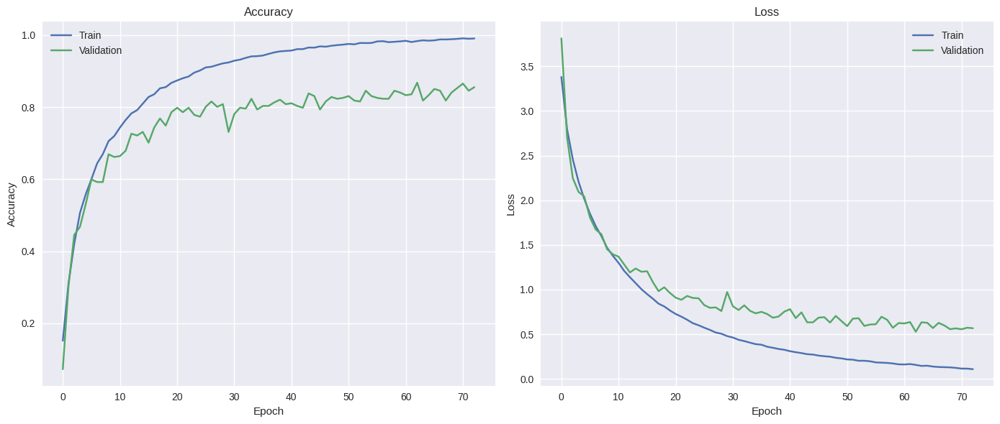

Best validation accuracy: 0.8681591749191284


In [38]:
log_df = pd.read_csv('CNN1.log')

plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
plt.plot(log_df['epoch'], log_df['accuracy'], label='Train')
plt.plot(log_df['epoch'], log_df['val_accuracy'], label='Validation')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(log_df['epoch'], log_df['loss'], label='Train')
plt.plot(log_df['epoch'], log_df['val_loss'], label='Validation')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.tight_layout()
plt.show()

best_acc = log_df['val_accuracy'].max()
print('Best validation accuracy:', best_acc)

In [39]:
model.load_weights('CNN1_model.h5')
[loss_test, acc_test] = model.evaluate(X_test_exp, y_test, verbose=0)
print(f"Test loss: {loss_test}")
print(f"Test accuracy: {acc_test}")

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing 

Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op OptionsDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op OptionsDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

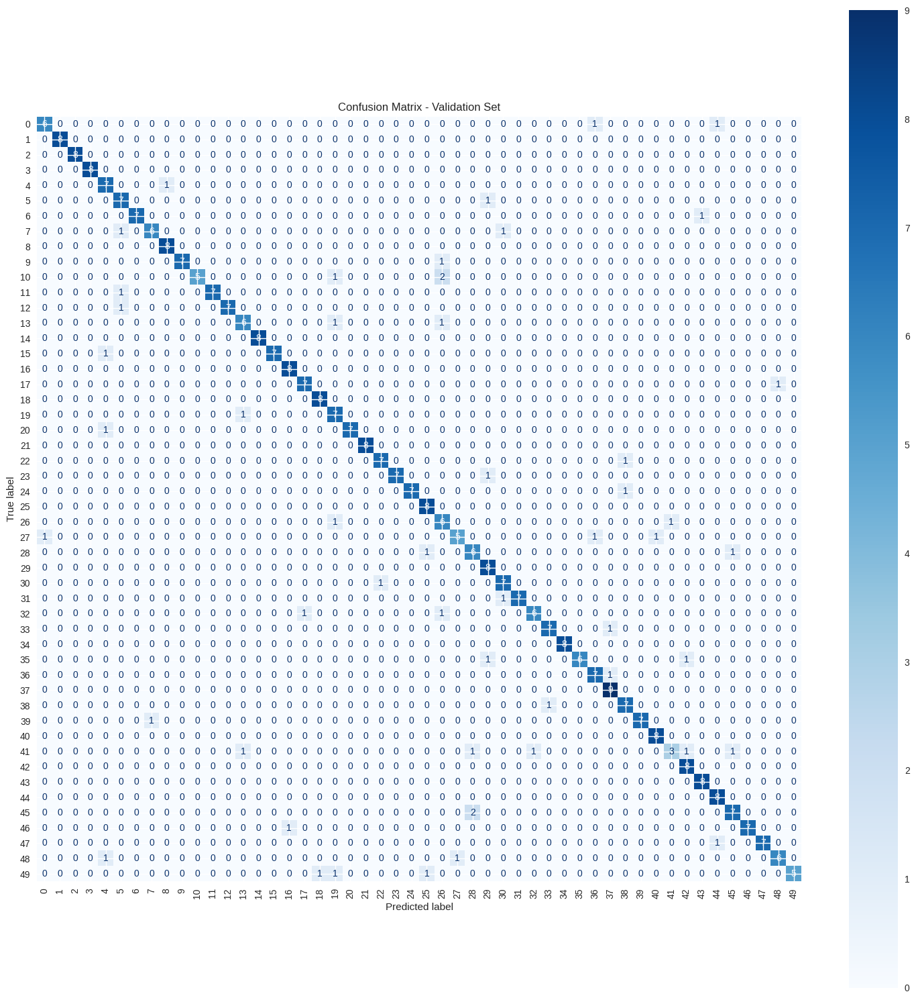

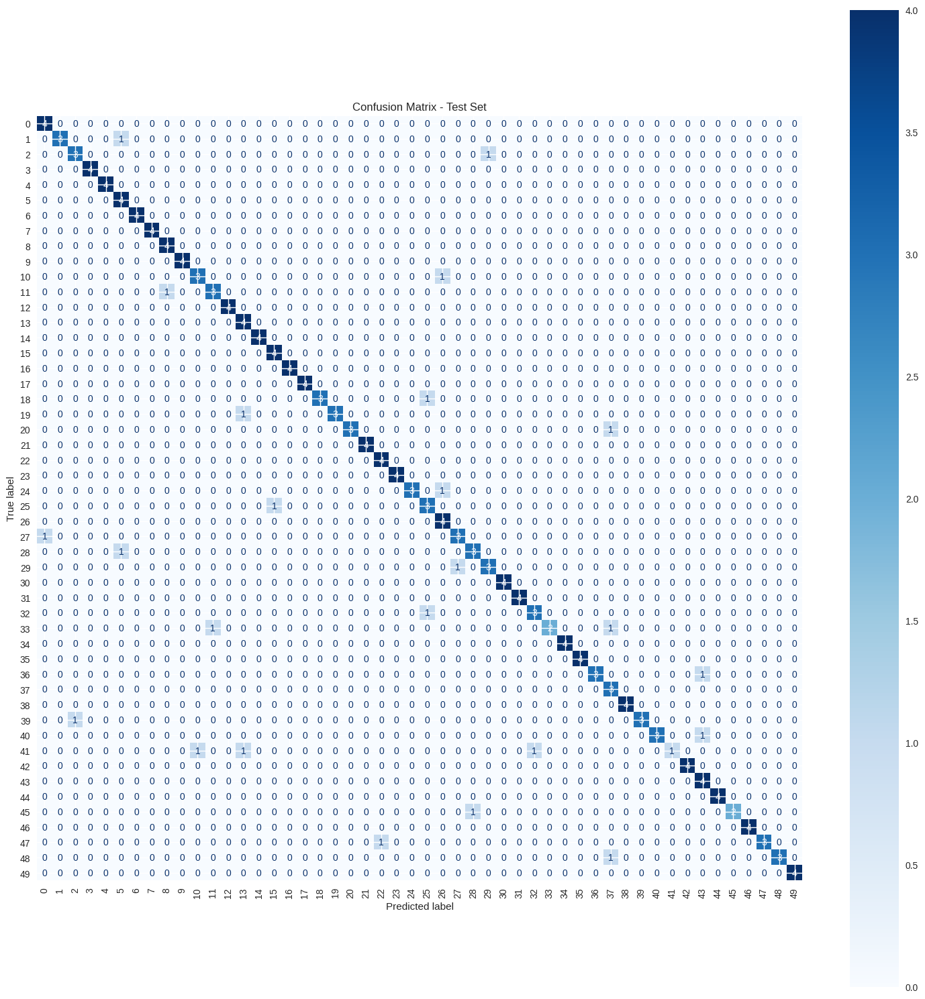

In [40]:
possible_classes = np.arange(0, 50)

pred_val = model.predict(X_val_exp)
pred_test = model.predict(X_test_exp)

pred_val_classes = np.argmax(pred_val, axis=1)
pred_test_classes = np.argmax(pred_test, axis=1)

# Confusion Matrix - Validation
cm_val = confusion_matrix(y_val, pred_val_classes)
fig_val, ax_val = plt.subplots(figsize=(15, 15))
disp_val = ConfusionMatrixDisplay(confusion_matrix=cm_val, display_labels=possible_classes)
disp_val.plot(cmap=plt.cm.Blues, ax=ax_val, xticks_rotation=90)
ax_val.set_title('Confusion Matrix - Validation Set')
plt.tight_layout()
plt.show()

# Confusion Matrix - Test
cm_test = confusion_matrix(y_test, pred_test_classes)
fig_test, ax_test = plt.subplots(figsize=(15, 15))
disp_test = ConfusionMatrixDisplay(confusion_matrix=cm_test, display_labels=possible_classes)
disp_test.plot(cmap=plt.cm.Blues, ax=ax_test, xticks_rotation=90)
ax_test.set_title('Confusion Matrix - Test Set')
plt.tight_layout()
plt.show()

In [41]:
print(classification_report(y_val, pred_val_classes, zero_division=0))

              precision    recall  f1-score   support

           0       0.86      0.75      0.80         8
           1       1.00      1.00      1.00         8
           2       1.00      1.00      1.00         8
           3       1.00      1.00      1.00         8
           4       0.70      0.88      0.78         8
           5       0.70      0.88      0.78         8
           6       1.00      0.88      0.93         8
           7       0.86      0.75      0.80         8
           8       0.89      1.00      0.94         8
           9       1.00      0.88      0.93         8
          10       1.00      0.62      0.77         8
          11       1.00      0.88      0.93         8
          12       1.00      0.88      0.93         8
          13       0.75      0.75      0.75         8
          14       1.00      1.00      1.00         8
          15       1.00      0.88      0.93         8
          16       0.89      1.00      0.94         8
          17       0.88    

In [42]:
print(classification_report(y_test, pred_test_classes, zero_division=0))

              precision    recall  f1-score   support

           0       0.80      1.00      0.89         4
           1       1.00      0.75      0.86         4
           2       0.75      0.75      0.75         4
           3       1.00      1.00      1.00         4
           4       1.00      1.00      1.00         4
           5       0.67      1.00      0.80         4
           6       1.00      1.00      1.00         4
           7       1.00      1.00      1.00         4
           8       0.80      1.00      0.89         4
           9       1.00      1.00      1.00         4
          10       0.75      0.75      0.75         4
          11       0.75      0.75      0.75         4
          12       1.00      1.00      1.00         4
          13       0.67      1.00      0.80         4
          14       1.00      1.00      1.00         4
          15       0.80      1.00      0.89         4
          16       1.00      1.00      1.00         4
          17       1.00    